In [1]:
# Load libraries
from keras import backend as K
from keras.models import load_model
from keras.preprocessing import image
from keras.optimizers import Adam
from imageio import imread
import numpy as np
import os
from tqdm import tqdm_notebook
from matplotlib import pyplot as plt

from models.keras_ssd300 import ssd_300
from keras_loss_function.keras_ssd_loss import SSDLoss
from keras_layers.keras_layer_AnchorBoxes import AnchorBoxes
from keras_layers.keras_layer_DecodeDetections import DecodeDetections
from keras_layers.keras_layer_DecodeDetectionsFast import DecodeDetectionsFast
from keras_layers.keras_layer_L2Normalization import L2Normalization

from ssd_encoder_decoder.ssd_output_decoder import decode_detections, decode_detections_fast

from data_generator.object_detection_2d_data_generator import DataGenerator
from data_generator.object_detection_2d_photometric_ops import ConvertTo3Channels
from data_generator.object_detection_2d_geometric_ops import Resize
from data_generator.object_detection_2d_misc_utils import apply_inverse_transforms

# Libraries for object finding
import cv2
from scipy.ndimage.measurements import find_objects
from scipy import ndimage
from scipy.ndimage.filters import gaussian_filter
import xml.etree.ElementTree as ET
import csv

# Libraries for VGG16 network
from keras import applications
from keras.preprocessing.image import ImageDataGenerator
from keras import optimizers
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from keras.callbacks import EarlyStopping, ModelCheckpoint
from skimage.transform import resize as RS
from skimage import img_as_ubyte

%matplotlib inline

Using TensorFlow backend.


### 1.1. Build the model and load trained weights into it

In [2]:
# 1: Build the Keras model
img_height = 300
img_width = 300
K.clear_session() # Clear previous models from memory.

model = ssd_300(image_size=(img_height, img_width, 3),
                n_classes=1,
                mode='inference',
                l2_regularization=0.0005,
                scales=[0.07, 0.15, 0.33, 0.51, 0.69, 0.87, 1.05], # The scales for MS COCO are [0.07, 0.15, 0.33, 0.51, 0.69, 0.87, 1.05]
                aspect_ratios_per_layer=[[1.0, 2.0, 0.5],
                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],
                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],
                                         [1.0, 2.0, 0.5, 3.0, 1.0/3.0],
                                         [1.0, 2.0, 0.5],
                                         [1.0, 2.0, 0.5]],
                two_boxes_for_ar1=True,
                steps=[8, 16, 32, 64, 100, 300],
                offsets=[0.5, 0.5, 0.5, 0.5, 0.5, 0.5],
                clip_boxes=False,
                variances=[0.1, 0.1, 0.2, 0.2],
                normalize_coords=True,
                subtract_mean=[123, 117, 104],
                swap_channels=[2, 1, 0],
                confidence_thresh=0.5,
                iou_threshold=0.45,
                top_k=200,
                nms_max_output_size=400)

# 2: Load the trained weights into the model.

# TODO: Set the path of the trained weights.
weights_path = 'ShipDetection-120_loss-2.8902_val_loss-2.7863.h5'

model.load_weights(weights_path, by_name=True)

# 3: Compile the model so that Keras won't complain the next time you load it.

adam = Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)

ssd_loss = SSDLoss(neg_pos_ratio=3, alpha=1.0)

model.compile(optimizer=adam, loss=ssd_loss.compute_loss)

# Data generator

In [3]:
def predict(folder):
    # Create a `BatchGenerator` instance

    dataset = DataGenerator()

    images_dir         = '../train/'
    annotations_dir    = '../NagyHazi/Annotation/'
    test_image_set_filename = folder

    # The XML parser needs to now what object class names to look for and in which order to map them to integers.
    classes = ['background','ship']

    dataset.parse_xml(images_dirs=[images_dir],
                      image_set_filenames=[test_image_set_filename],
                      annotations_dirs=[annotations_dir],
                      classes=classes,
                      include_classes='all',
                      exclude_truncated=False,
                      exclude_difficult=True,
                      ret=False)

    convert_to_3_channels = ConvertTo3Channels()
    resize = Resize(height=img_height, width=img_width)

    generator = dataset.generate(batch_size=1,
                                 shuffle=True,
                                 transformations=[convert_to_3_channels,
                                                  resize],
                                 returns={'processed_images',
                                          'filenames',
                                          'inverse_transform',
                                          'original_images',
                                          'original_labels'},
                                 keep_images_without_gt=False)
    make_prediction(DataGenerator.get_dataset_size(dataset), generator)

# Object detection

In [4]:
def object_detection(img):
    #img = cv2.imread(image)

    #Detect edges
    edges = cv2.Canny(img,150,200) #Canny Edge Detection #200 250
    edge = edges
    
    #Apply Gausian blur
    edges = gaussian_filter(edges, sigma=3)
    gauss = edges
    
    #Separate objects (label them differently)
    #https://stackoverflow.com/questions/16937158/extracting-connected-objects-from-an-image-in-python
    edges, nr_objects = ndimage.label(edges) 
    
    #Find objects (find x-y coordinates of rectangular)
    objects = find_objects(edges)
    
    objects_with_sizes = []
    #Calculate size of objects
    for obj in objects:
        ymin = obj[0].start
        ymax = obj[0].stop
        xmin = obj[1].start
        xmax = obj[1].stop
        area = (ymax - ymin) * (xmax - xmin)
        if(area < 115): #skip small objects
            continue
        if (ymax-ymin < 150 and xmax-xmin < 150):
            objects_with_sizes.append([xmin, ymin, xmax, ymax, area, True])
        

    #Sort
    #https://wiki.python.org/moin/HowTo/Sorting
    objects = sorted(objects_with_sizes, key=lambda obj: obj[4])

    #Select 20 largest elements
    objects = objects[-30:] #8

    #Merge (overlapping and close areas)
    for obj in objects:
        if(obj[5]):
            for o in objects:
                if(o[5]):
                    if(((o[0] < obj[0] and o[2] + 20 > obj[0]) or (o[0] - 20 < obj[2] and o[2] > obj[2])) and
                      ((o[1] < obj[1] and o[3] + 20 > obj[1]) or (o[1] - 20 < obj[3] and o[3] > obj[3])) and
                      o[4] < 60000 and obj[4] < 60000): #Limit maximum size
                        obj[0] = min(o[0], obj[0])
                        obj[1] = min(o[1], obj[1])
                        obj[2] = max(o[2], obj[2])
                        obj[3] = max(o[3], obj[3])
                        obj[4] = (obj[3] - obj[1]) * (obj[2] - obj[0])
                        o[5] = False #Set flag to zero
    result = []
    for obj in objects:
        if obj[5]:
            result.append(obj[0:4])
    return result

# VGG16

In [5]:
img_smallships_width, img_smallships_height = 224, 224 # dimensions of the images.

def preprocess_input(img): #using the same preprocessor as VGG16
    # 'RGB'->'BGR'
    img = img[:, :, ::-1]
    # Zero-center by mean pixel
    img[:, :, 0] -= 103.939
    img[:, :, 1] -= 116.779
    img[:, :, 2] -= 123.68
    return img

test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rescale=1. / 255)

# load the VGG16 network
# loading it without the fully connected layers at the top
base_model = applications.VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

model_smallships = Sequential()
for layer in base_model.layers: #adding the VGG16 layers
    model_smallships.add(layer)
model_smallships.add(Flatten(input_shape=model_smallships.output_shape[1:])) #add flatten layer
model_smallships.add(Dense(256, activation='relu')) #fully connected layers
model_smallships.add(Dropout(0.5)) #add dropout
model_smallships.add(Dense(1, activation='sigmoid')) #using sigmoid activation

# compile the model with a SGD/momentum optimizer
model_smallships.compile(loss='binary_crossentropy',
              optimizer=optimizers.SGD(lr=1e-3, momentum=0.9),
              metrics=['accuracy'])

model_smallships.load_weights("../NagyHazi/smallships_run/smallships_weights.hdf5", by_name=True)

# Merge overlapping boxes

In [6]:
def near(a, b, param):
    return a/b>=1-param and a/b<=1+param 

#are two bounding boxes nearly overlapping?
def is_overlap(boxA, boxB, param):
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[1], boxB[1])
    yA = max(boxA[2], boxB[2])
    xB = min(boxA[3], boxB[3])
    yB = min(boxA[4], boxB[4])

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[3] - boxA[1] + 1) * (boxA[4] - boxA[2] + 1)
    boxBArea = (boxB[3] - boxB[1] + 1) * (boxB[4] - boxB[2] + 1)

    return near(interArea, boxAArea, param) or near(interArea, boxBArea, param)

#combine overlapping bounding boxes
def repair_any(boxes, verbose):
    if verbose:
        print("total boxes:", len(boxes))
    for i in range(len(boxes)):
        for j in range(len(boxes)):
            if i != j and boxes[i][0] and boxes[j][0]: #Compare each box with every other boxes
                if is_overlap(boxes[i], boxes[j], .5): #Check if overlapping
                    if verbose:
                        print("found overlapping rectangles:", boxes[i], boxes[j])
                    newbox = [ #Set the new box to contain both child box
                        True,
                        min(boxes[i][1], boxes[j][1]), 
                        min(boxes[i][2], boxes[j][2]),
                        max(boxes[i][3], boxes[j][3]), 
                        max(boxes[i][4], boxes[j][4])
                    ]
                    if verbose:
                        print("replacing with new rectangle:", newbox)
                    boxes.append(newbox)
                    boxes[i][0] = False #Invalidate the other two
                    boxes[j][0] = False
                    return True
    return False


# Make prediction

In [14]:
def make_prediction(size_, generator):

    # Generate a batch and make predictions.
    for x in range(size_):
        batch_images, batch_filenames, batch_inverse_transforms, batch_original_images, batch_original_labels = next(generator)

        ii = 0 # Which batch item to look at

        objects = object_detection(batch_original_images[ii])

        orig_image = np.ndarray((768,768,3)) # Store the images here.
        input_images = np.ndarray((9,300,300,3)) # Store resized versions of the images here.
        input_images2 = []
        pos = [0,234,468]

        print("Image:", batch_filenames[ii])

        orig_image = batch_original_images[ii]
        for x in range(3):
            for y in range(3):
                input_images[x+y*3] = orig_image[pos[x]:pos[x]+300,pos[y]:pos[y]+300]

        for idx, obj in enumerate(objects):
            element = (np.array(orig_image[obj[1]:obj[3],obj[0]:obj[2]]))
            input_images2.append(element)

        y_pred = model.predict(input_images)
        y_pred_smallships = []

        for img in input_images2:
            new_shape = (img_smallships_width, img_smallships_height, 3)
            resize_ = np.empty(shape=new_shape)
            resize_ = img_as_ubyte(RS(img, new_shape, anti_aliasing=True))

            resize_ = np.expand_dims(resize_, 0)
            test_generator = test_datagen.flow(resize_,batch_size=1)
            pred = model_smallships.predict_generator(test_generator, steps=1)
            y_pred_smallships.append(pred)

        confidence_threshold = 0.5

        y_pred_thresh = [y_pred[k][y_pred[k,:,1] > confidence_threshold] for k in range(y_pred.shape[0])]

        # Display the image and draw the predicted boxes onto it.

        # Set the colors for the bounding boxes
        colors = plt.cm.hsv(np.linspace(0, 1, 21)).tolist()
        classes = ['background','ship']

        plt.figure(figsize=(20,12))
        plt.imshow(batch_original_images[ii])
        
        boxes = []
        for i in range(9):
            x = i // 3
            y = i % 3
            for box in y_pred_thresh[i]: #Transfer the boxes back onto the original image
                xmin = box[2] + pos[x]
                ymin = box[3] + pos[y]
                xmax = box[4] + pos[x]
                ymax = box[5] + pos[y]
                boxes.append([True, xmin, ymin, xmax, ymax])


        #Merge together overlapping boxes (the slicing can separate a ship onto 2 images)
        while repair_any(boxes, verbose = False):
            pass
    
        result_boxes = []
        for box in boxes:
            if box[0]:
                result_boxes.append([box[1], box[2], box[3], box[4]]) #Append in the result if box[0] validity flag is set

        for box in result_boxes:
            if box[0]: #If valid draw the box
                current_axis = plt.gca()
                xmin = box[0]
                ymin = box[1]
                xmax = box[2]
                ymax = box[3]
                label = "{:.2f}".format(box[1])
                current_axis.add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color='red', fill=False, linewidth=2))  
                current_axis.text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':'red', 'alpha':1.0})

        for box in batch_original_labels[ii]:
            current_axis = plt.gca()
            xmin = box[1]
            ymin = box[2]
            xmax = box[3]
            ymax = box[4]
            label = '{}'.format(classes[int(box[0])])
            current_axis.add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color='green', fill=False, linewidth=2))  
            current_axis.text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':'green', 'alpha':1.0})

        for idx, obj in enumerate(objects):
            if(y_pred_smallships[idx] > 0.5):
                current_axis = plt.gca()
                xmin = obj[0]
                ymin = obj[1]
                xmax = obj[2]
                ymax = obj[3]
                label = '{}'.format(y_pred_smallships[idx][0])
                current_axis.add_patch(plt.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, color='purple', fill=False, linewidth=2))  
                current_axis.text(xmin, ymin, label, size='x-large', color='white', bbox={'facecolor':'purple', 'alpha':1.0})

Processing image set 'test.txt': 100%|██████████| 50/50 [00:00<00:00, 379.40it/s]
Image: ../train/e5151ba14.jpg
Image: ../train/e4f2ea039.jpg
Image: ../train/e50a2e055.jpg
Image: ../train/e5022e3cf.jpg
Image: ../train/e5218cb7e.jpg
Image: ../train/e4d60bab5.jpg
Image: ../train/e4f20451c.jpg
Image: ../train/e50788e9b.jpg
Image: ../train/e4f1130c2.jpg
Image: ../train/e52502d92.jpg
Image: ../train/e4f78e293.jpg
Image: ../train/e4e99282f.jpg
Image: ../train/e4d7eb4df.jpg
Image: ../train/e513219c5.jpg
Image: ../train/e50af1bfd.jpg
Image: ../train/e51e4e4e3.jpg
Image: ../train/e50c829c9.jpg
Image: ../train/e5030f4e2.jpg
Image: ../train/e4fbf6655.jpg
Image: ../train/e4e56b3e1.jpg
Image: ../train/e4e323f96.jpg


/home/barackfa12/.local/lib/python3.5/site-packages/matplotlib/pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Image: ../train/e51970cad.jpg
Image: ../train/e519770dd.jpg
Image: ../train/e4ef760dd.jpg
Image: ../train/e517755c9.jpg
Image: ../train/e5249ca59.jpg
Image: ../train/e514e43b4.jpg
Image: ../train/e5071edd6.jpg
Image: ../train/e52e6c4d4.jpg
Image: ../train/e502c6240.jpg
Image: ../train/e50991e37.jpg
Image: ../train/e4f4bf1f0.jpg
Image: ../train/e4f167794.jpg
Image: ../train/e51261429.jpg
Image: ../train/e4f3410ac.jpg
Image: ../train/e5049cc8f.jpg
Image: ../train/e5171a1a8.jpg
Image: ../train/e4eca246e.jpg
Image: ../train/e4d8cf115.jpg
Image: ../train/e502b33ee.jpg
Image: ../train/e52eb00e2.jpg
Image: ../train/e4e71936e.jpg
Image: ../train/e4eb36de0.jpg
Image: ../train/e4f0798c3.jpg
Image: ../train/e4e089988.jpg
Image: ../train/e4e06e169.jpg
Image: ../train/e4f3dd705.jpg
Image: ../train/e4edc9e56.jpg
Image: ../train/e52f051f6.jpg
Image: ../train/e50465f3d.jpg


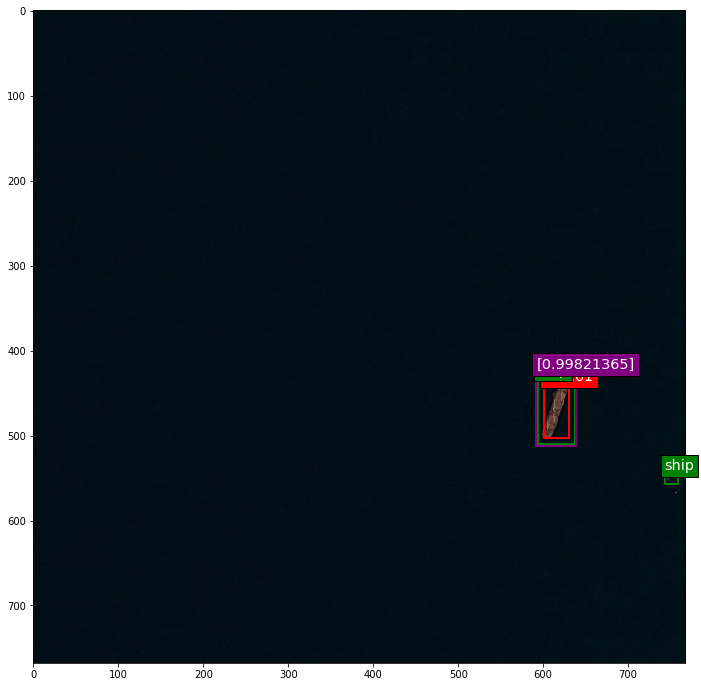

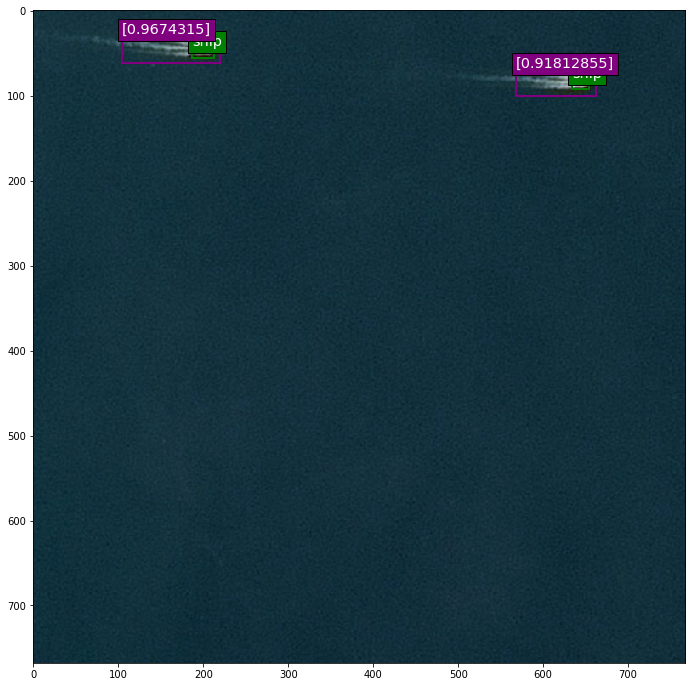

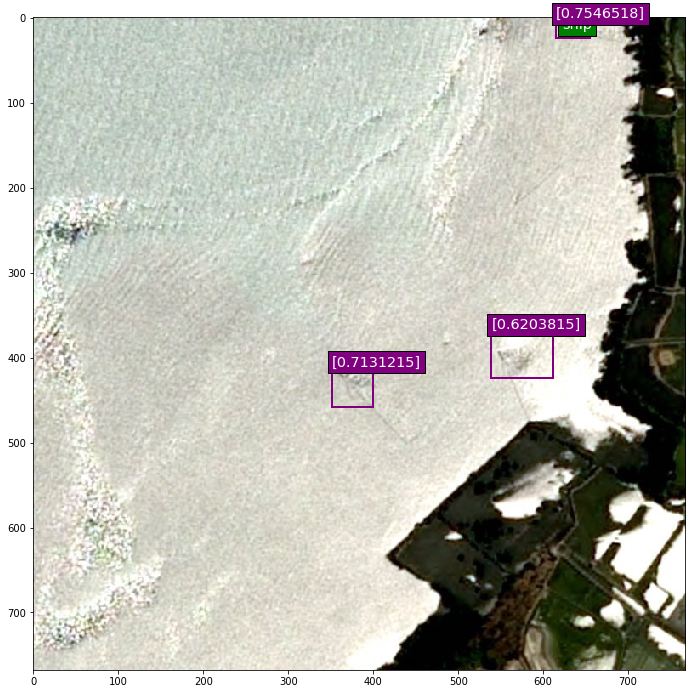

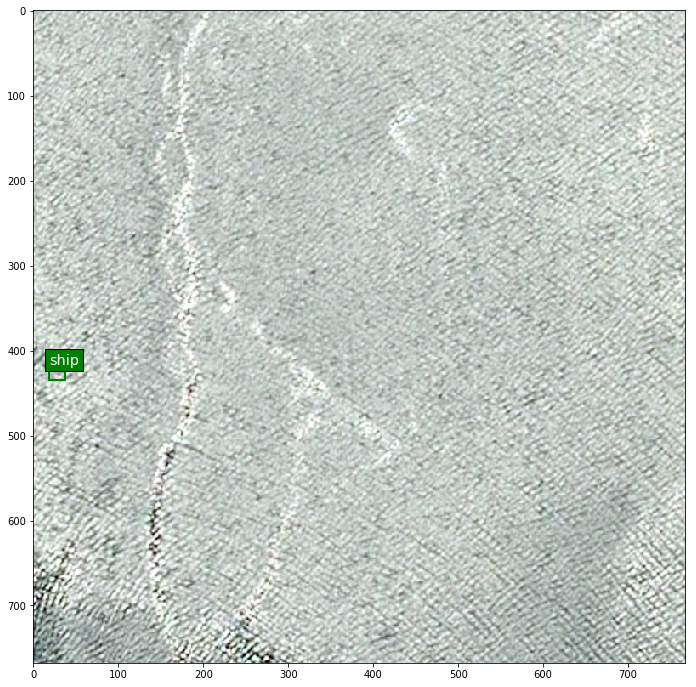

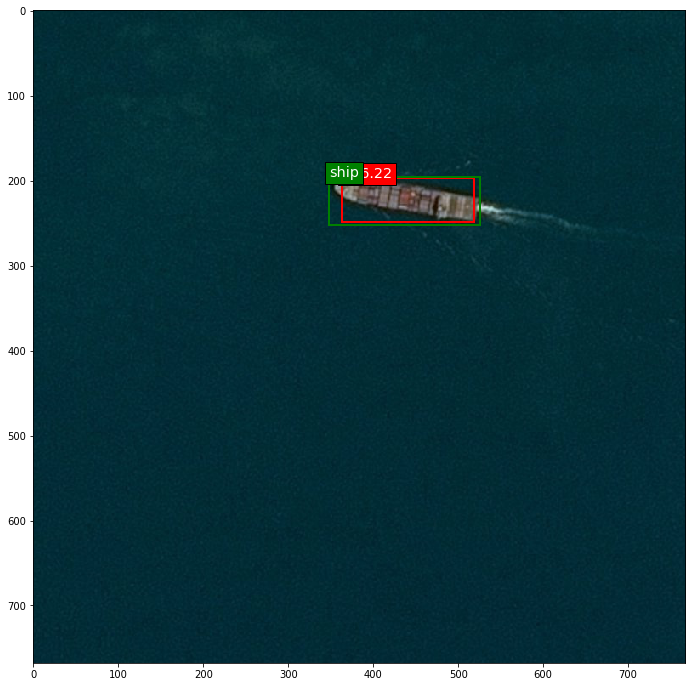

...

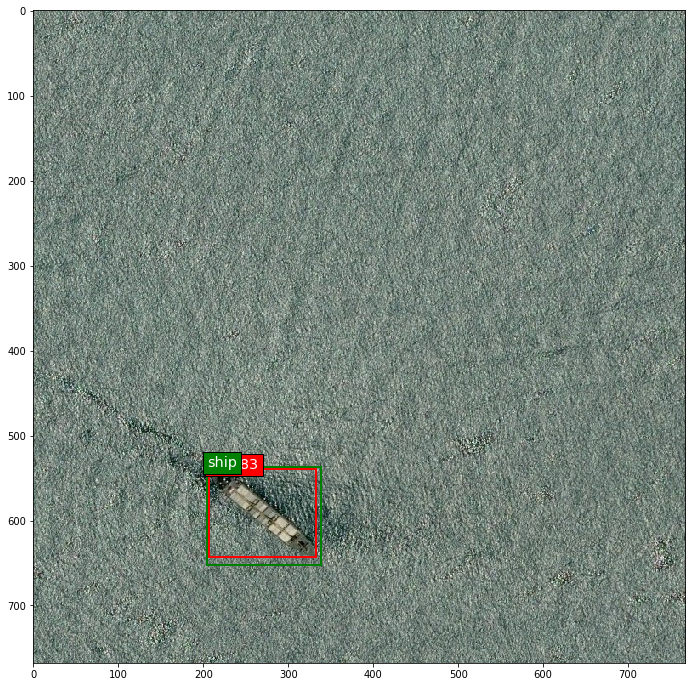

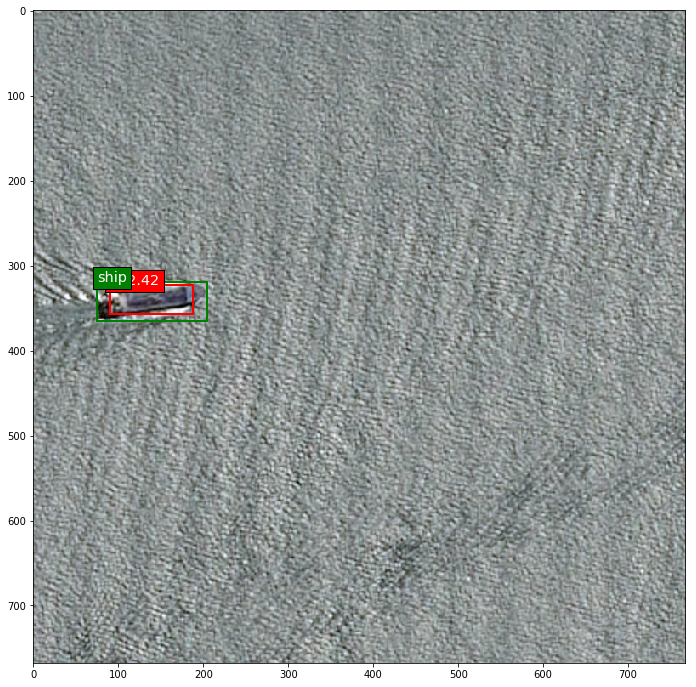

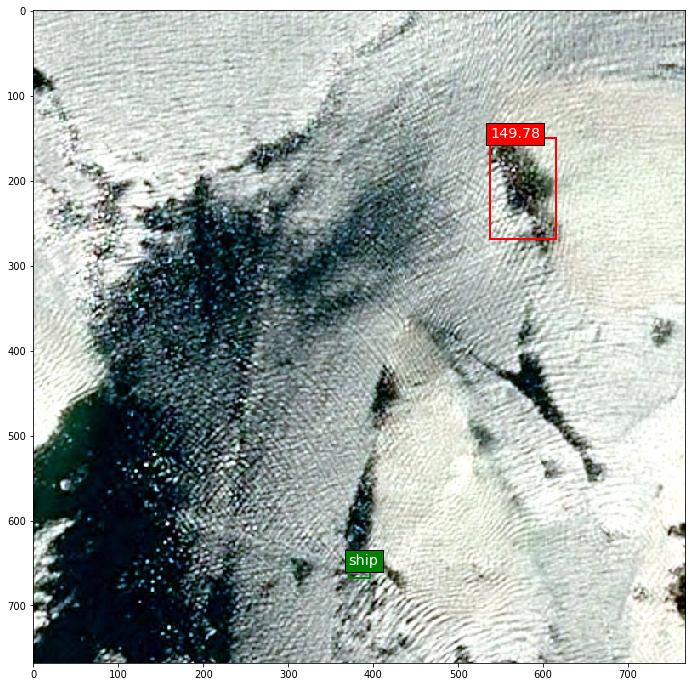

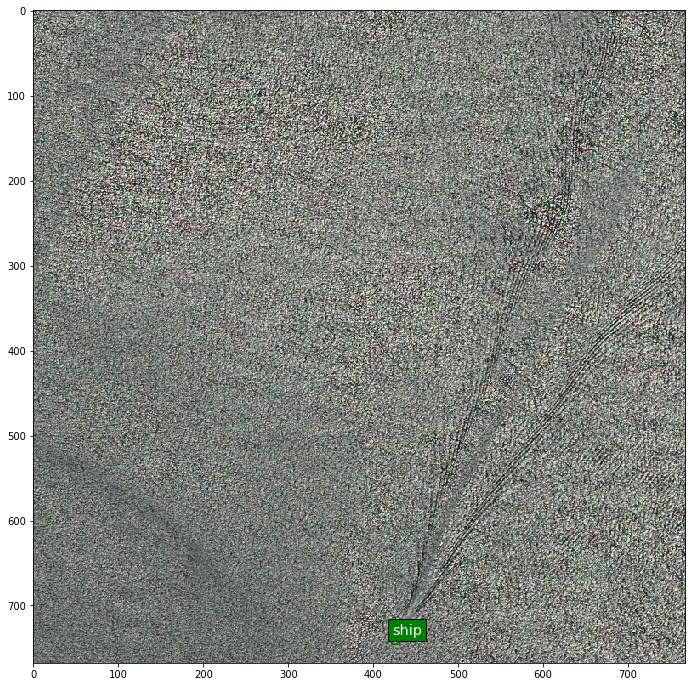

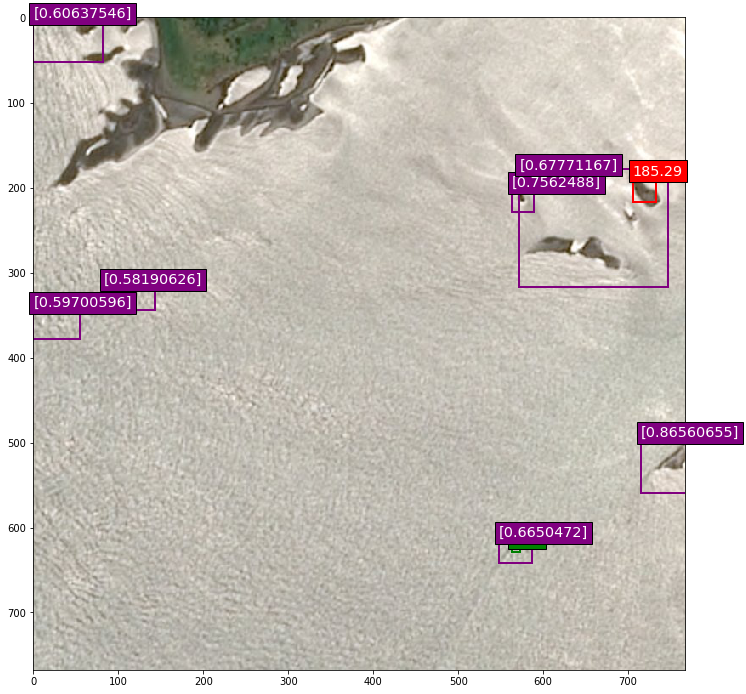

In [16]:
predict('../NagyHazi/ShipDetection/crop/test.txt')